# Import Packages

In [1]:
from LevyPlot import Scan2D
from LevyPlot import Scan3D
from LevyPlot import ProcessandPlot

In [2]:
import os
import shutil
import re
import math
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.io as pio
import plotly.graph_objects as go
pio.renderers.default = "notebook"
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
font = {'family' : 'Arial',
        'size'   : 14}
matplotlib.rc('font', **font)
matplotlib.rcParams['axes.linewidth'] = 0.8
matplotlib.rcParams["figure.dpi"] = 600

from scipy import signal
from scipy.optimize import curve_fit
from scipy import polyfit
import random

import json
from nptdms import TdmsWriter, RootObject, GroupObject, ChannelObject, TdmsFile
from tqdm import tqdm
from datetime import datetime
import pickle
from sklearn.cluster import KMeans

# Read data from tdms file

In [54]:
experiment = Scan2D(folder = '03-Sweep B IV',
                    metadata = dict(scantype = 'IV',
                                    groupsize = 16,
                                    monodirection = 'monodown',
                                    convertfilename = False,
                                    convertparam = dict(start = 0,
                                                        step = 1),
                                    dataofinterest = ['Magnet', 'Temperature', 'AO7', 'AI4', 'AI8', 'AI5', 'AI1'],
#                                     outmostsweepchannel = 'Temperature',
                                    outersweepchannel = 'Magnet',
                                    innersweepchannel = 'AO7',
                                    source = 'AO7',
                                    sourceamp = 0.000,
                                    Vplus = 'AI8',
                                    Vminus = 'AI8',
                                    Iminus = 'AI4'))

In [55]:
experiment.openTdms()

### double check channel names

In [56]:
experiment.printChannelInfo()

<TdmsChannel with path /'Data.000000'/'OFF'>
<TdmsChannel with path /'Data.000000'/'Magnet Field'>
<TdmsChannel with path /'Data.000000'/'Temperature'>
<TdmsChannel with path /'Data.000000'/'Magnet'>
<TdmsChannel with path /'Data.000000'/'time'>
<TdmsChannel with path /'Data.000000'/'AI1'>
<TdmsChannel with path /'Data.000000'/'AI2'>
<TdmsChannel with path /'Data.000000'/'AI3'>
<TdmsChannel with path /'Data.000000'/'AI4'>
<TdmsChannel with path /'Data.000000'/'AI5'>
<TdmsChannel with path /'Data.000000'/'AI6'>
<TdmsChannel with path /'Data.000000'/'AI7'>
<TdmsChannel with path /'Data.000000'/'AI8'>
<TdmsChannel with path /'Data.000000'/'AO1'>
<TdmsChannel with path /'Data.000000'/'AO2'>
<TdmsChannel with path /'Data.000000'/'AO3'>
<TdmsChannel with path /'Data.000000'/'AO4'>
<TdmsChannel with path /'Data.000000'/'AO5'>
<TdmsChannel with path /'Data.000000'/'AO6'>
<TdmsChannel with path /'Data.000000'/'AO7'>
<TdmsChannel with path /'Data.000000'/'AO8'>


### read data

In [57]:
experiment.tdmsToAveragedMonoDfConcatenated()

  1%|          | 2/266 [00:00<00:16, 16.25it/s]

Reading from TdmsFile to Pandas Dataframe


100%|██████████| 266/266 [00:13<00:00, 19.04it/s]


### this is the Pandas dataframe we finally get:

In [58]:
experiment.monodfconcatenated

,datapoint,Temperature,AO7,AI4,AI8,AI5,AI1,V2T,V4T
Magnet,,,,,,,,,
0.031249,1877.0,0.060616,-0.005493,-9.965588e-08,-0.000098,-0.000123,-0.000029,-0.005493,-0.000098
0.031249,1876.0,0.060616,-0.005492,-9.964726e-08,-0.000098,-0.000123,-0.000030,-0.005492,-0.000098
0.031249,1875.0,0.060616,-0.005486,-9.954839e-08,-0.000098,-0.000124,-0.000030,-0.005486,-0.000098
0.031249,1874.0,0.060616,-0.005478,-9.939552e-08,-0.000098,-0.000123,-0.000031,-0.005478,-0.000098
0.031249,1873.0,0.060616,-0.005469,-9.923384e-08,-0.000098,-0.000123,-0.000030,-0.005469,-0.000098
0.031249,1872.0,0.060616,-0.005460,-9.907371e-08,-0.000098,-0.000122,-0.000029,-0.005460,-0.000098
0.031249,1871.0,0.060616,-0.005451,-9.891551e-08,-0.000097,-0.000122,-0.000029,-0.005451,-0.000097
0.031249,1870.0,0.060616,-0.005442,-9.875561e-08,-0.000097,-0.000122,-0.000029,-0.005442,-0.000097
0.031249,1869.0,0.060616,-0.005434,-9.859879e-08,-0.000097,-0.000122,-0.000029,-0.005434,-0.000097


# Create pivot table, in this case a V4T vs I vs B table

In [59]:
experiment.createPivotTable(parameters = dict(x = 'AI4', y = 'V4T', num_of_points = 2000,\
                                                 auto_xrange = True, xmin = -1e-7, xmax = 1e-7,\
                                                 lowpass_filter = False, cutoff = 60, fs = 1000,\
                                                 remove_repeated_x = False))

  1%|          | 2/266 [00:00<00:18, 14.27it/s]

Building Pivot Table


100%|██████████| 266/266 [00:17<00:00, 15.11it/s]


In [60]:
experiment.pivottable

,-9.991686393588718e-08,-9.981693303264871e-08,-9.971700212941025e-08,-9.961707122617178e-08,-9.951714032293332e-08,-9.941720941969485e-08,-9.931727851645639e-08,-9.921734761321792e-08,-9.911741670997946e-08,-9.901748580674098e-08,...,9.894563350866025e-08,9.904556441189872e-08,9.914549531513719e-08,9.924542621837564e-08,9.934535712161411e-08,9.944528802485258e-08,9.954521892809105e-08,9.964514983132953e-08,9.974508073456797e-08,9.984501163780646e-08
Magnet,,,,,,,,,,,,,,,,,,,,,
0.031249,NaN,NaN,NaN,-0.000098,-0.000098,-0.000098,-0.000098,-0.000098,-0.000098,-0.000097,...,0.000096,0.000096,0.000096,0.000096,0.000096,0.000096,0.000097,NaN,NaN,NaN
0.031009,NaN,NaN,NaN,-0.000098,-0.000098,-0.000098,-0.000098,-0.000098,-0.000097,-0.000097,...,0.000096,0.000096,0.000097,0.000097,0.000097,0.000097,0.000097,NaN,NaN,NaN
0.030756,NaN,NaN,NaN,-0.000098,-0.000098,-0.000098,-0.000098,-0.000098,-0.000097,-0.000097,...,0.000096,0.000096,0.000096,0.000096,0.000097,0.000097,0.000097,NaN,NaN,NaN
0.030514,NaN,NaN,NaN,-0.000098,-0.000098,-0.000098,-0.000098,-0.000098,-0.000098,-0.000097,...,0.000096,0.000096,0.000096,0.000096,0.000096,0.000096,0.000097,NaN,NaN,NaN
0.030245,NaN,NaN,NaN,-0.000099,-0.000099,-0.000099,-0.000098,-0.000098,-0.000098,-0.000098,...,0.000095,0.000095,0.000095,0.000096,0.000096,0.000096,0.000096,NaN,NaN,NaN
0.029995,NaN,NaN,NaN,-0.000098,-0.000098,-0.000098,-0.000098,-0.000097,-0.000097,-0.000097,...,0.000096,0.000096,0.000096,0.000096,0.000096,0.000096,0.000097,NaN,NaN,NaN
0.029747,NaN,NaN,NaN,-0.000098,-0.000098,-0.000098,-0.000098,-0.000098,-0.000098,-0.000097,...,0.000096,0.000096,0.000096,0.000096,0.000096,0.000097,0.000097,NaN,NaN,NaN
0.029499,NaN,NaN,NaN,-0.000097,-0.000097,-0.000097,-0.000097,-0.000097,-0.000096,-0.000096,...,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,NaN,NaN,NaN
0.029252,NaN,NaN,NaN,-0.000099,-0.000099,-0.000099,-0.000099,-0.000099,-0.000099,-0.000099,...,0.000094,0.000095,0.000095,0.000095,0.000095,0.000095,0.000095,NaN,NaN,NaN


In [61]:
ProcessandPlot.intensityPlot(experiment.pivottable, zmin = -80, zmax = 80,
                             zscale = 1e6, yscale = 1e4, xscale = 1e9, colorscale = 'RdBu',
                             xlabel = 'I (nA)', ylabel = 'B (oe)', zlabel = 'V (uV)',
                             width = 700, height = 600)

In [62]:
plot1 = ProcessandPlot.intensityPlot(experiment.pivottable, zmin = -80, zmax = 80,
                             zscale = 1e6, yscale = 1e4, xscale = 1e9, colorscale = 'RdBu',
                             xlabel = 'I (nA)', ylabel = 'B (oe)', zlabel = 'V (uV)',
                             width = 500, height = 500, title = 'V vs I vs B')
plot1.update_layout(
    yaxis = dict(
        range = [-200, 200],
        tickmode = 'linear',
        tick0 = 0,
        dtick = 50,
        ticklen=3),
    xaxis = dict(
        range = [-93, 93],
        tickmode = 'linear',
        tick0 = 0,
        dtick = 40,
        ticklen=3))
plot1.write_image('03-Sweep B IV-V vs I vs B' + ".png")
plot1.show()

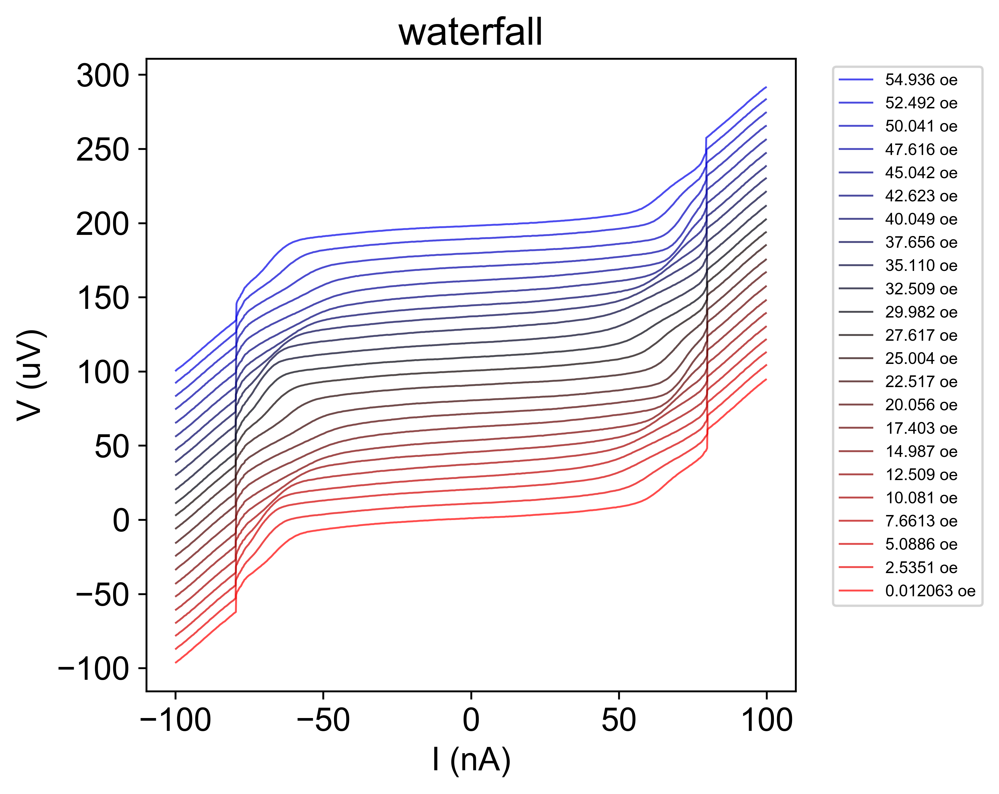

In [113]:
fig, ax = ProcessandPlot.waterfallPlotHorizontal(experiment.pivottable, start = 125, step = -1, num = 23, vert_offset = 9e-6, hor_offset = 0,\
                                xscale = 1e9, yscale = 1e6, legendscale = 1e4, legendunit = 'oe',\
                                xlabel = 'I (nA)', ylabel = 'V (uV)', title = 'waterfall', savefig = False)
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], fontsize = 7, bbox_to_anchor = [0, 0, 1.3, 1])
fig.set_size_inches(5, 5)
fig.savefig('03-Sweep B IV-VvsI-waterfall.svg')

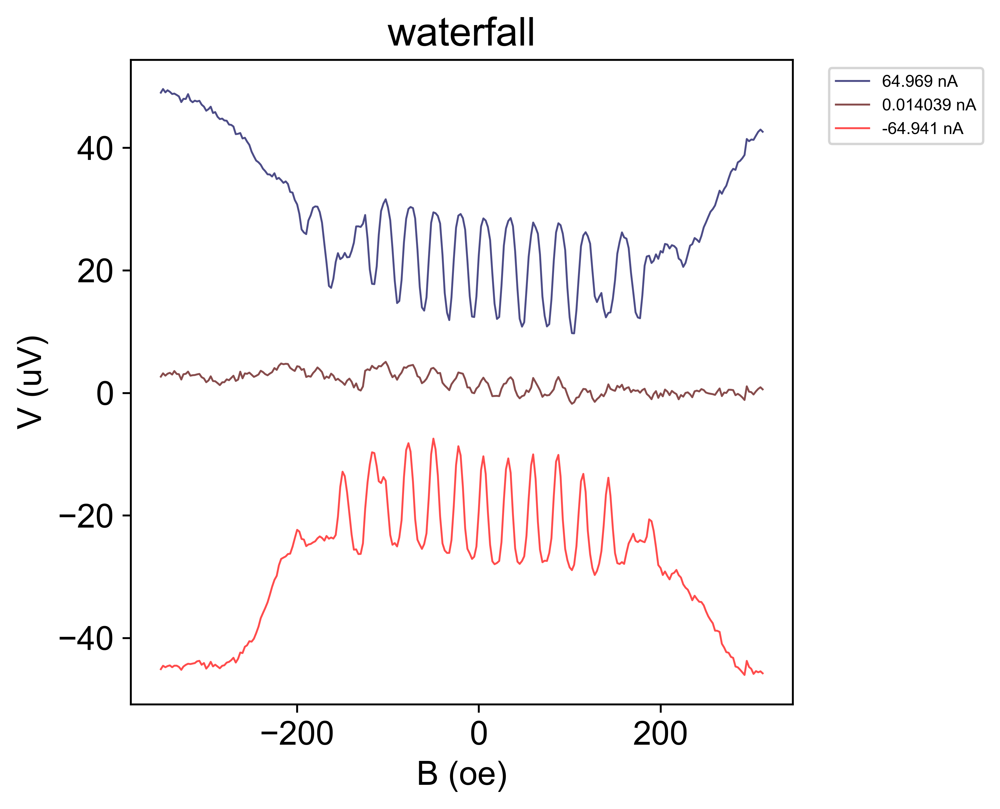

In [98]:
fig, ax = ProcessandPlot.waterfallPlotVertical(experiment.pivottable, start = 350, step = 650, num = 3, vert_offset = 0, hor_offset = 0,\
                                xscale = 1e4, yscale = 1e6, legendscale = 1e9, legendunit = 'nA',\
                                xlabel = 'B (oe)', ylabel = 'V (uV)', title = 'waterfall', savefig = False)
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], fontsize = 7, bbox_to_anchor = [0, 0, 1.3, 1])
fig.set_size_inches(5, 5)
# fig.savefig('03-VvsB.png')

# Differentiate the IV curves to get dV/dI vs I

In [93]:
experiment.differentiateTable(parameters = dict(columnstep = 50, columninter = 5, rowstep = 0, rowinter = 1))

  3%|▎         | 7/266 [00:00<00:08, 29.17it/s]

Differentiating Pivot Table against Column


100%|██████████| 266/266 [00:06<00:00, 41.01it/s]


Differentiating Pivot Table against Row
Differentiating Pivot Table against Both Row and Column


In [112]:
plot2 = ProcessandPlot.intensityPlot(experiment.pivottabledX, zmin = 0, zmax = 4,
                             zscale = 1e-3, yscale = 1e4, xscale = 1e9, colorscale = 'Plasma',
                             xlabel = 'I (nA)', ylabel = 'B (oe)', zlabel = 'R (kOhm)',
                             width = 500, height = 500)
plot2.update_layout(
    yaxis = dict(
        range = [-200, 200],
        tickmode = 'linear',
        tick0 = 0,
        dtick = 50,
        ticklen=3),
    xaxis = dict(
        range = [-93, 93],
        tickmode = 'linear',
        tick0 = 0,
        dtick = 40,
        ticklen=3))
plot2.write_image('03-Sweep B IV-dVdI vs I vs B' + ".png")
plot2.show()

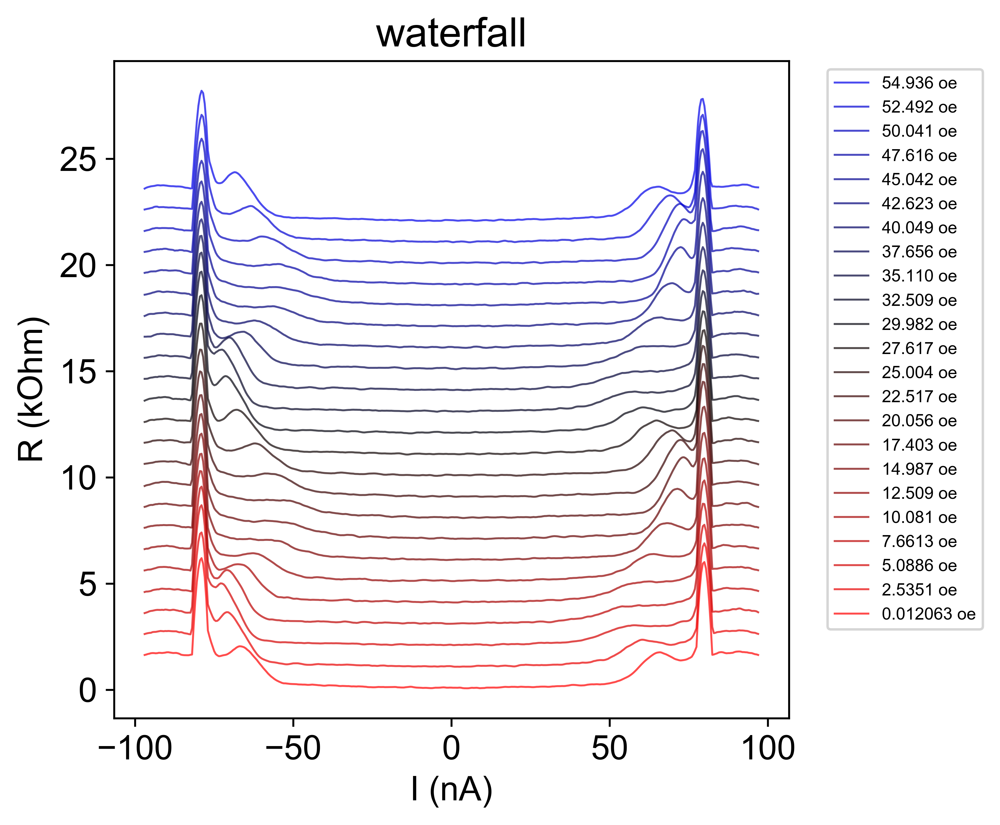

In [114]:
fig, ax = ProcessandPlot.waterfallPlotHorizontal(experiment.pivottabledX, start = 125, step = -1, num = 23, vert_offset = 1e3, hor_offset = 0,\
                                xscale = 1e9, yscale = 1e-3, legendscale = 1e4, legendunit = 'oe',\
                                xlabel = 'I (nA)', ylabel = 'R (kOhm)', title = 'waterfall', savefig = False)
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], fontsize = 7, bbox_to_anchor = [0, 0, 1.3, 1])
fig.set_size_inches(5, 5)
fig.savefig('03-Sweep B IV-dVdIvsI-waterfall.svg')

# Extract critical current from dV/dI

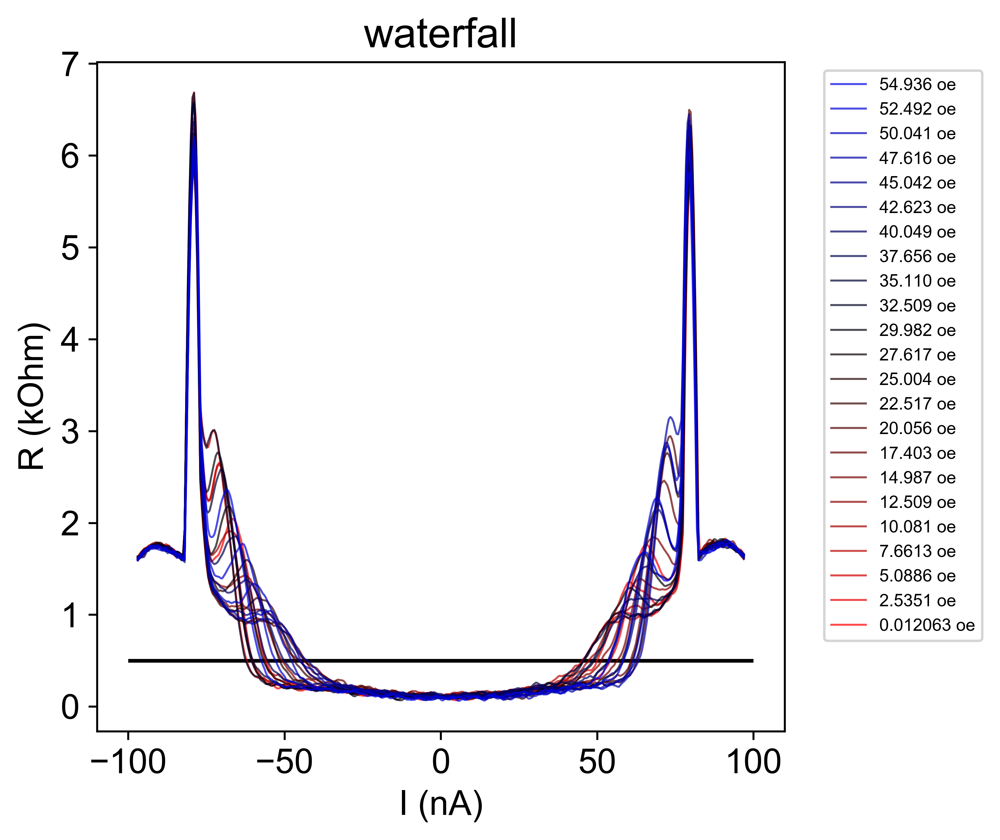

In [118]:
fig, ax = ProcessandPlot.waterfallPlotHorizontal(experiment.pivottabledX, start = 125, step = -1, num = 23, vert_offset = 0, hor_offset = 0,\
                                xscale = 1e9, yscale = 1e-3, legendscale = 1e4, legendunit = 'oe',\
                                xlabel = 'I (nA)', ylabel = 'R (kOhm)', title = 'waterfall', savefig = False)
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], fontsize = 7, bbox_to_anchor = [0, 0, 1.3, 1])
ax.hlines([0.5], xmin = -100, xmax = 100)
fig.set_size_inches(5, 5)
# fig.savefig('03-Sweep B IV-dVdIvsI-waterfall.svg')

In [123]:
Icplus_list, Icminus_list = ProcessandPlot.extractIc(experiment.pivottable, experiment.pivottabledX,
                         algorithm = 'ResistanceThreshold', threshold = 500)

100%|██████████| 266/266 [00:00<00:00, 1563.16it/s]


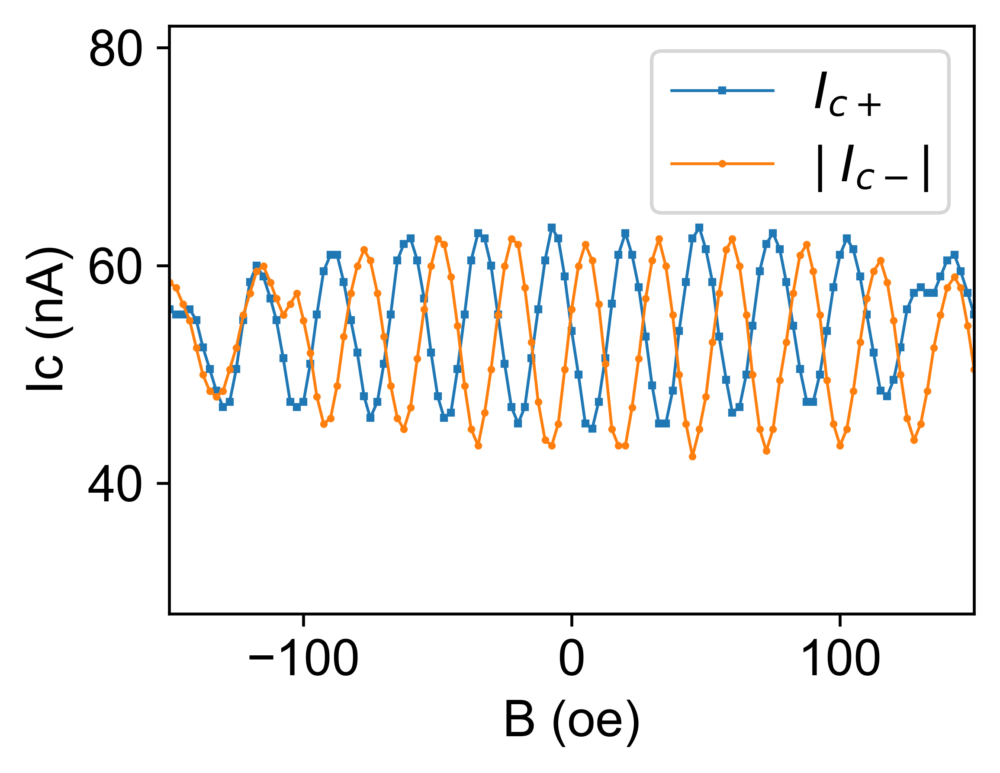

In [158]:
fig, ax = plt.subplots(figsize = (4, 3))
ax.plot(Icplus_list.index * 1e4, Icplus_list.values * 1e9, 's-', lw = 0.8, markersize = 1.1)
ax.plot(Icminus_list.index * 1e4, -Icminus_list.values * 1e9, 'o-', lw = 0.8, markersize = 1.1)
ax.set_xlabel('B (oe)')
ax.set_ylabel('Ic (nA)')
ax.set_xlim((-150, 150))
ax.set_ylim((28, 82))
ax.legend(['$I_{c+}$', '| $I_{c-}$|'])
fig.savefig('03-Sweep B IV-Ic vs B')
